In [3]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader


In [4]:
torch.cuda.is_available() 

True

In [5]:
# Set random seed for reproducibility
seed = 999
torch.manual_seed(seed)
np.random.seed(seed)

# Hyper Parameters

In [8]:
# Number of workers for dataloader
workers = 2
# Batch size during training
batch_size = 128
# Spatial size of training images
image_size = 64
# Number of channels in the training images
nc = 3
# Size of z latent vector (generator input)
nz = 100
# Size of feature maps in generator
ngf = 64
# Size of feature maps in discriminator
ndf = 64
# Number of training epochs
num_epochs = 5   #<<<<<<<<<<<-- remember to change this 
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparameter for Adam optimizer
beta1 = 0.5


In [9]:
# Device configuration
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
# Dataset folder in my Pc
data_root="D:\celeb_dataset\images"

In [10]:
device

device(type='cuda', index=0)

# Downloading Dataset

In [11]:
# Download and preprocess CelebA dataset
def get_celeba_dataset():
    # Create transform
    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
    
    # Download CelebA dataset
    # Note: You need to manually download from https://mmlab.ie.cuhk.edu.hk/projects/CelebA.html
    # and place it in the data_root directory as "img_align_celeba". it is about 1GB.
    
    # Create dataset
    dataset = dset.ImageFolder(root=os.path.dirname(data_root), transform=transform)
    
    # Create the dataloader
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)
    
    return dataloader

In [12]:
# Helper function to denormalize and display images
def denormalize(tensor, mean, std):
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)  # Reverse normalization
    return tensor


def show_images(images, nrow=4):
    #Denormalize the images
    images = denormalize(images, mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    # Reorder to (batch_size, height, width, channels)
    images = images.permute(0, 2, 3, 1)
    fig, axes = plt.subplots(1, nrow, figsize=(15, 5))
    for i in range(nrow):
        img = (images[i] + 1) / 2  # Rescale from [-1, 1] to [0, 1]
        axes[i].imshow(img.numpy())
        axes[i].axis("off")
    plt.show()

torch.Size([128, 3, 64, 64])


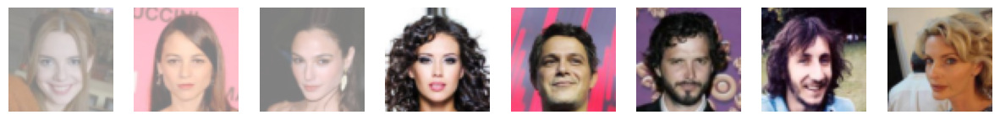

In [14]:
dataloader=get_celeba_dataset()
batch = next(iter(dataloader))  # Get one batch
images, _ = batch  # ImageFolder returns images and class labels, ignore labels

print(images.shape) #Batch shape

#display
show_images(images, nrow=8)  # Display batch


In [15]:

# Generator Network
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size: (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size: (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size: (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size: (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size: (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

# Discriminator Network
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

# Initialize model weights
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [16]:
import matplotlib.pyplot as plt
import torchvision.utils as vutils

# Visualization function
def visualize_training(real_batch, fake_batch, G_losses, D_losses, epoch, batch):
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    # Plot real images
    axs[0].imshow(np.transpose(vutils.make_grid(real_batch[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))
    axs[0].set_title("Real Images")
    axs[0].axis("off")

    # Plot fake images
    axs[1].imshow(np.transpose(vutils.make_grid(fake_batch[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))
    axs[1].set_title("Fake Images (Generated)")
    axs[1].axis("off")

    # Plot loss curve
    axs[2].plot(G_losses, label="Generator Loss", color='blue')
    axs[2].plot(D_losses, label="Discriminator Loss", color='red')
    axs[2].legend()
    axs[2].set_title("Loss Curve")
    axs[2].set_xlabel("Iterations")
    axs[2].set_ylabel("Loss")

    plt.suptitle(f"Epoch {epoch}, Batch {batch}")
    plt.show()

Starting Training Loop...


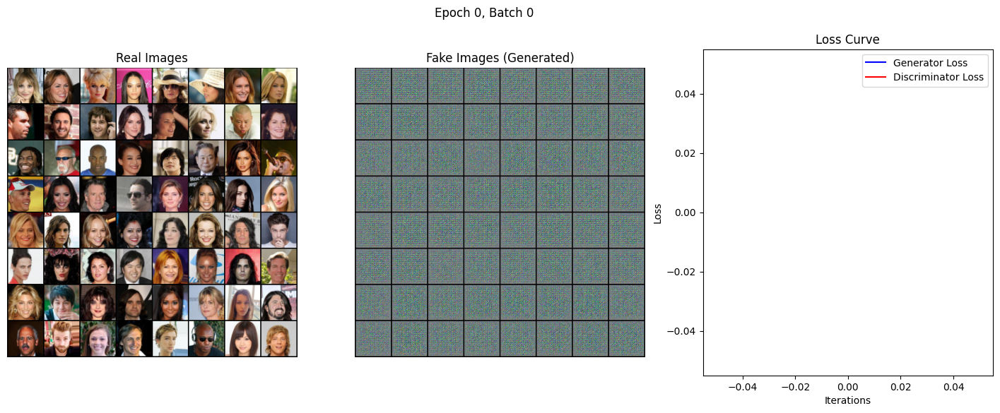

[0/5][0/1547] Loss_D: 1.8874 Loss_G: 4.1852 D(x): 0.4167 D(G(z)): 0.4997/0.0224
[0/5][50/1547] Loss_D: 1.1044 Loss_G: 25.6829 D(x): 0.9656 D(G(z)): 0.5948/0.0000
[0/5][100/1547] Loss_D: 0.8559 Loss_G: 10.7188 D(x): 0.9440 D(G(z)): 0.3742/0.0001
[0/5][150/1547] Loss_D: 0.6547 Loss_G: 7.9121 D(x): 0.9672 D(G(z)): 0.4075/0.0022
[0/5][200/1547] Loss_D: 1.3350 Loss_G: 8.6208 D(x): 0.9826 D(G(z)): 0.6352/0.0005
[0/5][250/1547] Loss_D: 0.9967 Loss_G: 5.9588 D(x): 0.9726 D(G(z)): 0.5173/0.0058
[0/5][300/1547] Loss_D: 0.8295 Loss_G: 6.6454 D(x): 0.9069 D(G(z)): 0.4557/0.0032
[0/5][350/1547] Loss_D: 0.4431 Loss_G: 4.0155 D(x): 0.8854 D(G(z)): 0.2444/0.0266
[0/5][400/1547] Loss_D: 0.3929 Loss_G: 2.7110 D(x): 0.8100 D(G(z)): 0.0436/0.1204
[0/5][450/1547] Loss_D: 0.5151 Loss_G: 3.5114 D(x): 0.7583 D(G(z)): 0.1131/0.0646


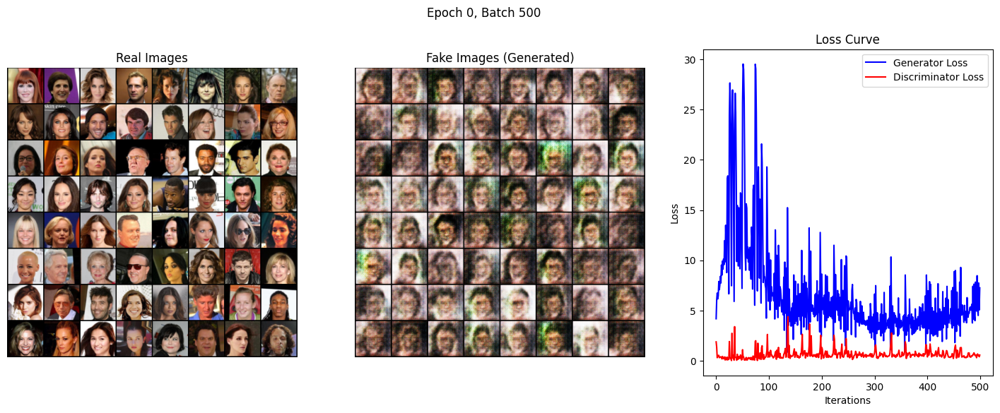

[0/5][500/1547] Loss_D: 0.6400 Loss_G: 3.4123 D(x): 0.6488 D(G(z)): 0.0592/0.0526
[0/5][550/1547] Loss_D: 0.6999 Loss_G: 6.2494 D(x): 0.9206 D(G(z)): 0.3827/0.0057
[0/5][600/1547] Loss_D: 0.7392 Loss_G: 3.1635 D(x): 0.6133 D(G(z)): 0.0326/0.0834
[0/5][650/1547] Loss_D: 0.9976 Loss_G: 5.5606 D(x): 0.5101 D(G(z)): 0.0065/0.0116
[0/5][700/1547] Loss_D: 0.3206 Loss_G: 5.2612 D(x): 0.8485 D(G(z)): 0.0822/0.0108
[0/5][750/1547] Loss_D: 0.8844 Loss_G: 2.7868 D(x): 0.6246 D(G(z)): 0.1839/0.0922
[0/5][800/1547] Loss_D: 0.4974 Loss_G: 4.3435 D(x): 0.8425 D(G(z)): 0.2224/0.0223
[0/5][850/1547] Loss_D: 0.5644 Loss_G: 3.1892 D(x): 0.7018 D(G(z)): 0.0492/0.0758
[0/5][900/1547] Loss_D: 1.2762 Loss_G: 7.5046 D(x): 0.4354 D(G(z)): 0.0008/0.0039
[0/5][950/1547] Loss_D: 0.4369 Loss_G: 5.5708 D(x): 0.9322 D(G(z)): 0.2619/0.0102


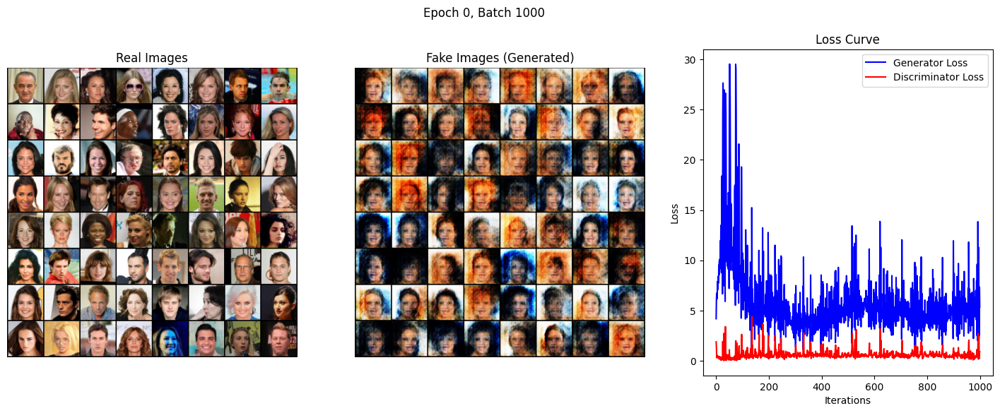

[0/5][1000/1547] Loss_D: 0.3351 Loss_G: 2.8425 D(x): 0.8488 D(G(z)): 0.1130/0.1255
[0/5][1050/1547] Loss_D: 0.6403 Loss_G: 4.3664 D(x): 0.8202 D(G(z)): 0.2775/0.0265
[0/5][1100/1547] Loss_D: 0.3039 Loss_G: 3.9368 D(x): 0.8789 D(G(z)): 0.1058/0.0471
[0/5][1150/1547] Loss_D: 0.4068 Loss_G: 4.7860 D(x): 0.7580 D(G(z)): 0.0274/0.0188
[0/5][1200/1547] Loss_D: 0.3795 Loss_G: 4.9366 D(x): 0.7736 D(G(z)): 0.0570/0.0157
[0/5][1250/1547] Loss_D: 0.5656 Loss_G: 3.4441 D(x): 0.7472 D(G(z)): 0.1710/0.0539
[0/5][1300/1547] Loss_D: 0.3716 Loss_G: 4.3691 D(x): 0.9034 D(G(z)): 0.1826/0.0264
[0/5][1350/1547] Loss_D: 0.4419 Loss_G: 3.6070 D(x): 0.8116 D(G(z)): 0.1444/0.0496
[0/5][1400/1547] Loss_D: 0.8706 Loss_G: 2.8655 D(x): 0.5211 D(G(z)): 0.0075/0.1011
[0/5][1450/1547] Loss_D: 0.2170 Loss_G: 5.7635 D(x): 0.9415 D(G(z)): 0.1243/0.0060


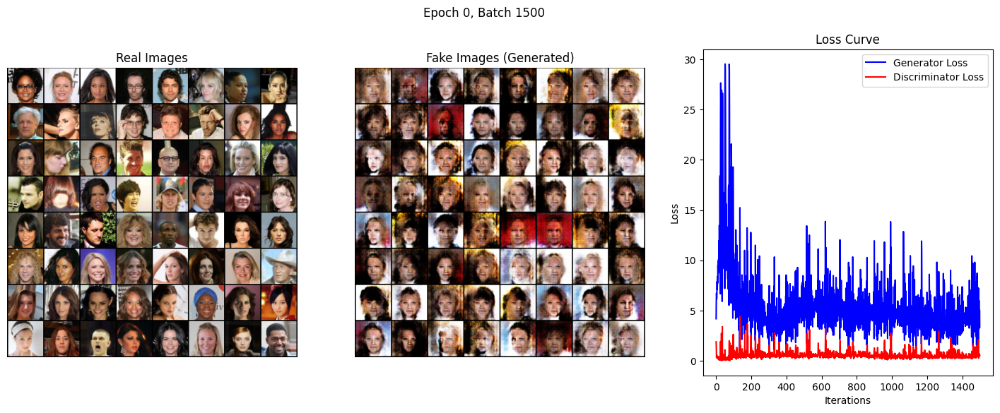

[0/5][1500/1547] Loss_D: 0.5788 Loss_G: 3.6355 D(x): 0.8081 D(G(z)): 0.2190/0.0508


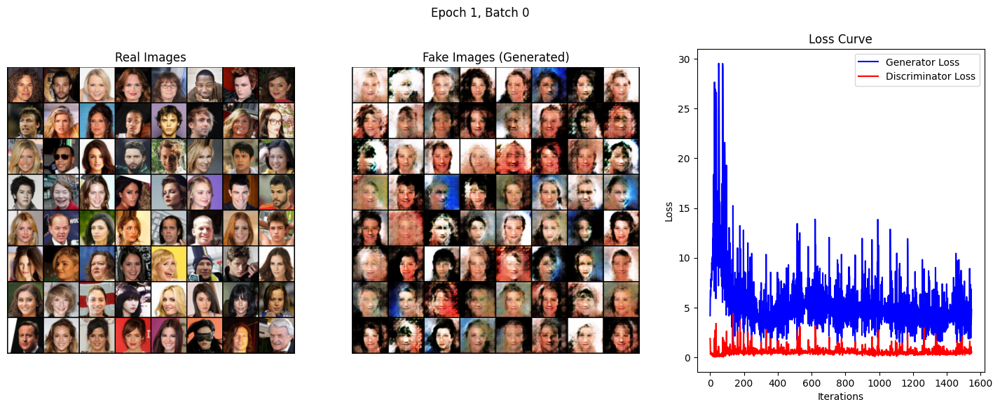

[1/5][0/1547] Loss_D: 0.3248 Loss_G: 3.8553 D(x): 0.7982 D(G(z)): 0.0508/0.0346
[1/5][50/1547] Loss_D: 0.4891 Loss_G: 4.5160 D(x): 0.8706 D(G(z)): 0.2502/0.0165
[1/5][100/1547] Loss_D: 0.7322 Loss_G: 6.0686 D(x): 0.9607 D(G(z)): 0.4361/0.0074
[1/5][150/1547] Loss_D: 0.3481 Loss_G: 4.9896 D(x): 0.7840 D(G(z)): 0.0456/0.0205
[1/5][200/1547] Loss_D: 1.0199 Loss_G: 2.0831 D(x): 0.5060 D(G(z)): 0.0318/0.1822
[1/5][250/1547] Loss_D: 0.7842 Loss_G: 1.9446 D(x): 0.6953 D(G(z)): 0.2184/0.1987
[1/5][300/1547] Loss_D: 0.3846 Loss_G: 4.1526 D(x): 0.8701 D(G(z)): 0.1816/0.0298
[1/5][350/1547] Loss_D: 0.3911 Loss_G: 3.9661 D(x): 0.8720 D(G(z)): 0.1852/0.0321
[1/5][400/1547] Loss_D: 2.6059 Loss_G: 2.7021 D(x): 0.1742 D(G(z)): 0.0007/0.1318
[1/5][450/1547] Loss_D: 0.3121 Loss_G: 3.5567 D(x): 0.9422 D(G(z)): 0.1966/0.0517


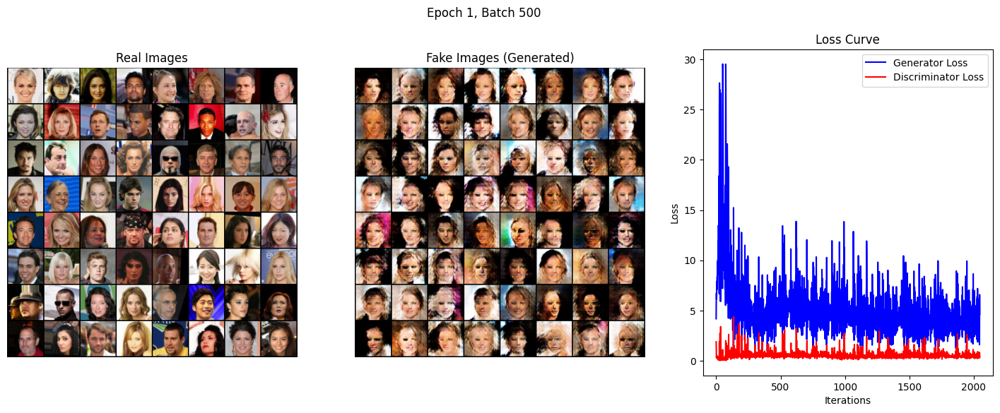

[1/5][500/1547] Loss_D: 0.4441 Loss_G: 1.9519 D(x): 0.7553 D(G(z)): 0.0916/0.2129
[1/5][550/1547] Loss_D: 0.3789 Loss_G: 4.2289 D(x): 0.8953 D(G(z)): 0.1915/0.0282
[1/5][600/1547] Loss_D: 0.3321 Loss_G: 3.6441 D(x): 0.8354 D(G(z)): 0.0991/0.0411
[1/5][650/1547] Loss_D: 0.2926 Loss_G: 4.1949 D(x): 0.9042 D(G(z)): 0.1514/0.0226
[1/5][700/1547] Loss_D: 0.5516 Loss_G: 4.5008 D(x): 0.8461 D(G(z)): 0.2721/0.0174
[1/5][750/1547] Loss_D: 0.5312 Loss_G: 5.6030 D(x): 0.9384 D(G(z)): 0.3277/0.0076
[1/5][800/1547] Loss_D: 0.4055 Loss_G: 3.4071 D(x): 0.8130 D(G(z)): 0.1362/0.0551
[1/5][850/1547] Loss_D: 0.8557 Loss_G: 0.7351 D(x): 0.5179 D(G(z)): 0.0431/0.5469
[1/5][900/1547] Loss_D: 0.4597 Loss_G: 4.0282 D(x): 0.8903 D(G(z)): 0.2515/0.0286
[1/5][950/1547] Loss_D: 0.4167 Loss_G: 3.6618 D(x): 0.7741 D(G(z)): 0.0922/0.0448


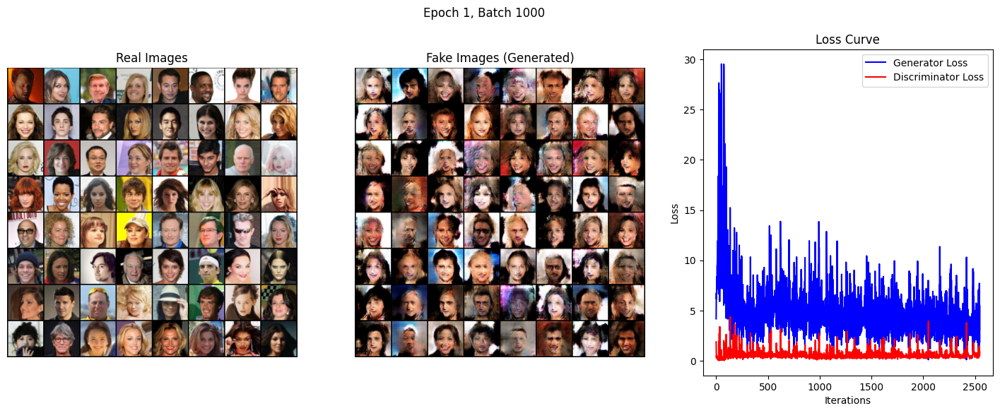

[1/5][1000/1547] Loss_D: 1.0170 Loss_G: 6.7373 D(x): 0.9435 D(G(z)): 0.5234/0.0030
[1/5][1050/1547] Loss_D: 0.3865 Loss_G: 2.4841 D(x): 0.8160 D(G(z)): 0.1276/0.1146
[1/5][1100/1547] Loss_D: 0.4193 Loss_G: 3.3579 D(x): 0.7425 D(G(z)): 0.0575/0.0559
[1/5][1150/1547] Loss_D: 1.2981 Loss_G: 1.0991 D(x): 0.4019 D(G(z)): 0.0355/0.4257
[1/5][1200/1547] Loss_D: 0.4866 Loss_G: 3.8194 D(x): 0.8242 D(G(z)): 0.2012/0.0334
[1/5][1250/1547] Loss_D: 0.6016 Loss_G: 3.1331 D(x): 0.9049 D(G(z)): 0.3231/0.0728
[1/5][1300/1547] Loss_D: 0.5253 Loss_G: 2.2384 D(x): 0.7182 D(G(z)): 0.0979/0.1551
[1/5][1350/1547] Loss_D: 0.4651 Loss_G: 2.9423 D(x): 0.7192 D(G(z)): 0.0546/0.0873
[1/5][1400/1547] Loss_D: 0.8332 Loss_G: 4.2539 D(x): 0.7462 D(G(z)): 0.3442/0.0233
[1/5][1450/1547] Loss_D: 0.4476 Loss_G: 2.4664 D(x): 0.7717 D(G(z)): 0.1237/0.1218


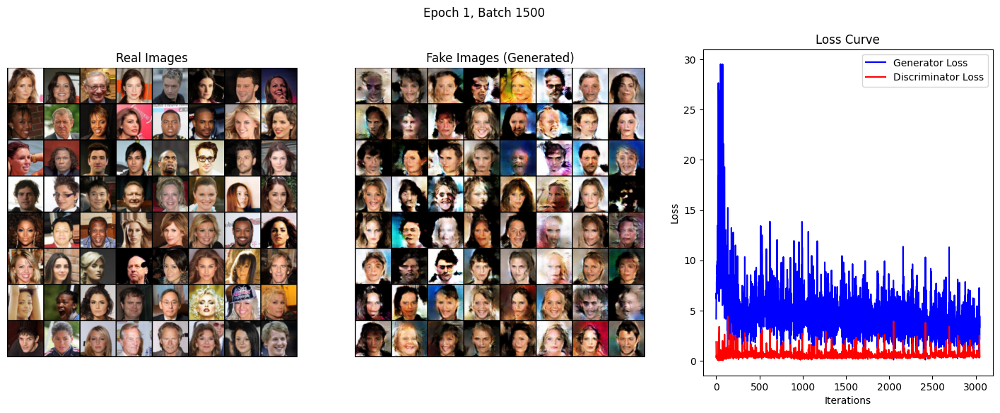

[1/5][1500/1547] Loss_D: 0.8675 Loss_G: 1.1733 D(x): 0.6327 D(G(z)): 0.2241/0.4021


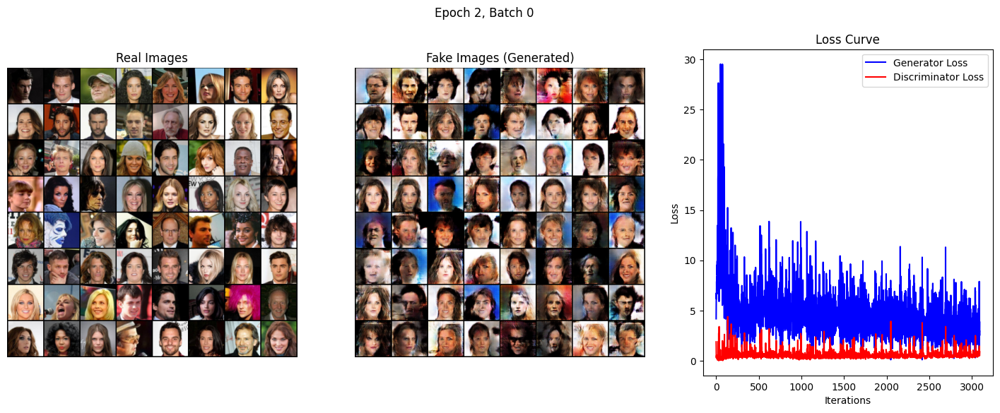

[2/5][0/1547] Loss_D: 0.4120 Loss_G: 2.8202 D(x): 0.8068 D(G(z)): 0.1414/0.0942
[2/5][50/1547] Loss_D: 0.5369 Loss_G: 3.3670 D(x): 0.8896 D(G(z)): 0.2996/0.0522
[2/5][100/1547] Loss_D: 1.2461 Loss_G: 1.6946 D(x): 0.4038 D(G(z)): 0.0556/0.2567
[2/5][150/1547] Loss_D: 0.5072 Loss_G: 3.7934 D(x): 0.8956 D(G(z)): 0.2972/0.0328
[2/5][200/1547] Loss_D: 0.6883 Loss_G: 3.6782 D(x): 0.8638 D(G(z)): 0.3746/0.0353
[2/5][250/1547] Loss_D: 0.6004 Loss_G: 4.0895 D(x): 0.8506 D(G(z)): 0.3124/0.0259
[2/5][300/1547] Loss_D: 0.8997 Loss_G: 2.8107 D(x): 0.6975 D(G(z)): 0.3420/0.0859
[2/5][350/1547] Loss_D: 0.6227 Loss_G: 2.9357 D(x): 0.8521 D(G(z)): 0.3328/0.0753
[2/5][400/1547] Loss_D: 1.3039 Loss_G: 5.6456 D(x): 0.9593 D(G(z)): 0.6545/0.0067
[2/5][450/1547] Loss_D: 0.5944 Loss_G: 2.0045 D(x): 0.7335 D(G(z)): 0.1982/0.1688


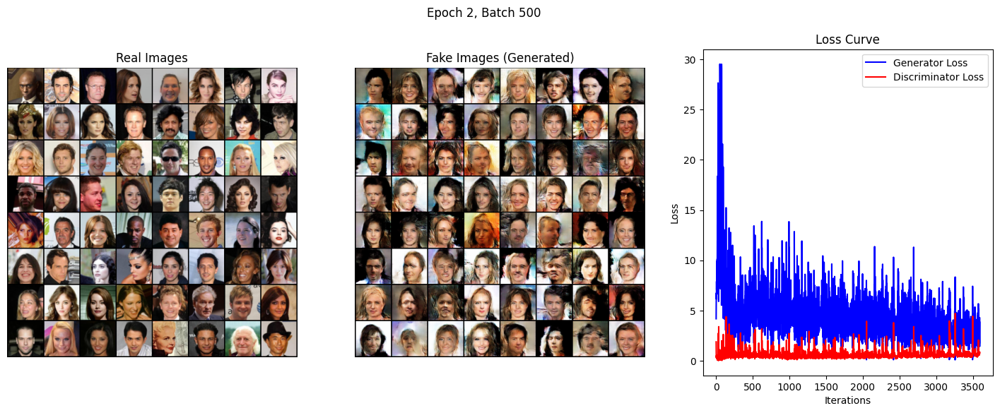

[2/5][500/1547] Loss_D: 0.5579 Loss_G: 2.3348 D(x): 0.6718 D(G(z)): 0.0767/0.1314
[2/5][550/1547] Loss_D: 0.4837 Loss_G: 3.2589 D(x): 0.8521 D(G(z)): 0.2456/0.0537
[2/5][600/1547] Loss_D: 0.6573 Loss_G: 1.6716 D(x): 0.6507 D(G(z)): 0.1123/0.2380
[2/5][650/1547] Loss_D: 0.6271 Loss_G: 2.2112 D(x): 0.6359 D(G(z)): 0.0814/0.1503
[2/5][700/1547] Loss_D: 0.5027 Loss_G: 2.8002 D(x): 0.8703 D(G(z)): 0.2672/0.0905
[2/5][750/1547] Loss_D: 0.4851 Loss_G: 2.1971 D(x): 0.7892 D(G(z)): 0.1907/0.1346
[2/5][800/1547] Loss_D: 0.7071 Loss_G: 1.6991 D(x): 0.6576 D(G(z)): 0.1923/0.2245
[2/5][850/1547] Loss_D: 1.0187 Loss_G: 2.0345 D(x): 0.4516 D(G(z)): 0.0561/0.1816
[2/5][900/1547] Loss_D: 2.0213 Loss_G: 6.0708 D(x): 0.9678 D(G(z)): 0.8121/0.0043
[2/5][950/1547] Loss_D: 0.7052 Loss_G: 2.5979 D(x): 0.7711 D(G(z)): 0.3039/0.1008


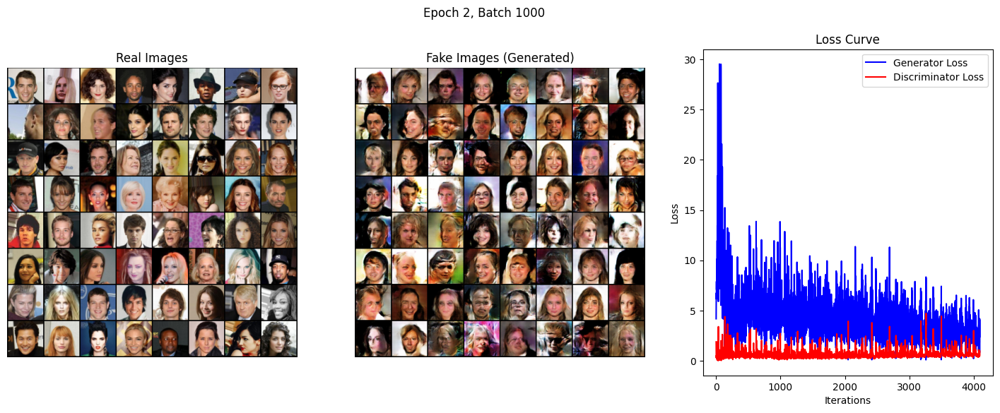

[2/5][1000/1547] Loss_D: 0.4777 Loss_G: 2.5303 D(x): 0.8465 D(G(z)): 0.2247/0.1091
[2/5][1050/1547] Loss_D: 0.6919 Loss_G: 3.8467 D(x): 0.8704 D(G(z)): 0.3695/0.0323
[2/5][1100/1547] Loss_D: 0.5694 Loss_G: 2.5899 D(x): 0.7949 D(G(z)): 0.2470/0.0979
[2/5][1150/1547] Loss_D: 0.6812 Loss_G: 3.8618 D(x): 0.9348 D(G(z)): 0.4223/0.0301
[2/5][1200/1547] Loss_D: 0.5114 Loss_G: 2.3986 D(x): 0.8341 D(G(z)): 0.2472/0.1183
[2/5][1250/1547] Loss_D: 1.7019 Loss_G: 0.4752 D(x): 0.2569 D(G(z)): 0.0137/0.6522
[2/5][1300/1547] Loss_D: 0.4967 Loss_G: 2.5960 D(x): 0.8313 D(G(z)): 0.2408/0.0972
[2/5][1350/1547] Loss_D: 0.5292 Loss_G: 1.8138 D(x): 0.7250 D(G(z)): 0.1398/0.2008
[2/5][1400/1547] Loss_D: 0.5688 Loss_G: 2.4723 D(x): 0.7112 D(G(z)): 0.1486/0.1176
[2/5][1450/1547] Loss_D: 0.4832 Loss_G: 2.4064 D(x): 0.7794 D(G(z)): 0.1772/0.1194


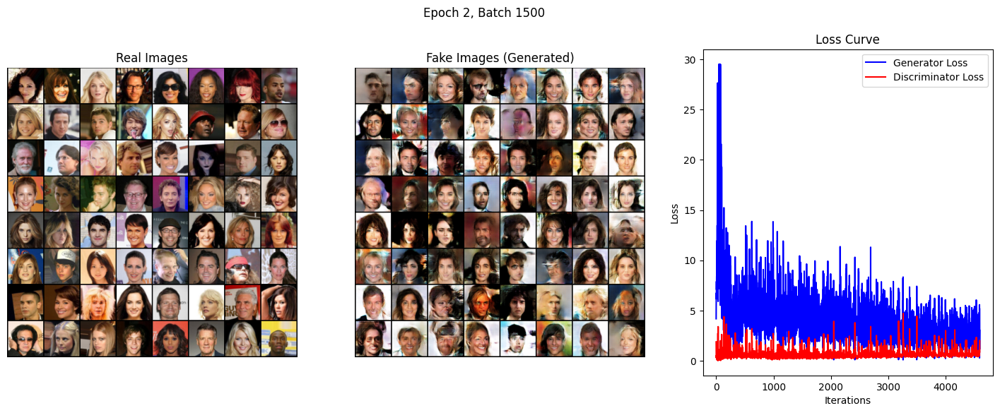

[2/5][1500/1547] Loss_D: 1.1829 Loss_G: 0.7168 D(x): 0.4432 D(G(z)): 0.1781/0.5375


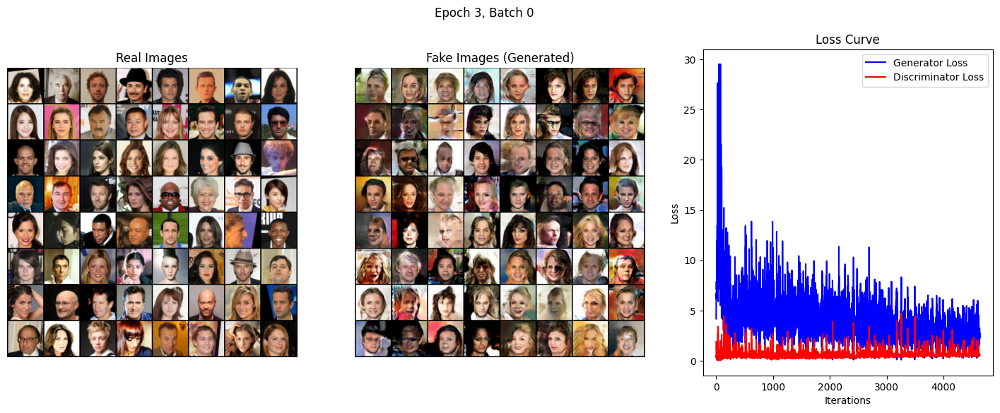

[3/5][0/1547] Loss_D: 0.5825 Loss_G: 2.5885 D(x): 0.8065 D(G(z)): 0.2727/0.1015
[3/5][50/1547] Loss_D: 1.0155 Loss_G: 1.7443 D(x): 0.5704 D(G(z)): 0.2501/0.2273
[3/5][100/1547] Loss_D: 0.6522 Loss_G: 3.4665 D(x): 0.9111 D(G(z)): 0.4013/0.0392
[3/5][150/1547] Loss_D: 0.5678 Loss_G: 3.8120 D(x): 0.9207 D(G(z)): 0.3564/0.0289
[3/5][200/1547] Loss_D: 0.4907 Loss_G: 2.5079 D(x): 0.7905 D(G(z)): 0.1958/0.1036
[3/5][250/1547] Loss_D: 0.7816 Loss_G: 1.7684 D(x): 0.6719 D(G(z)): 0.2489/0.2166
[3/5][300/1547] Loss_D: 0.5137 Loss_G: 2.4155 D(x): 0.8048 D(G(z)): 0.2302/0.1092
[3/5][350/1547] Loss_D: 0.7012 Loss_G: 3.1364 D(x): 0.8866 D(G(z)): 0.3932/0.0599
[3/5][400/1547] Loss_D: 0.5126 Loss_G: 3.1084 D(x): 0.8834 D(G(z)): 0.2917/0.0595
[3/5][450/1547] Loss_D: 1.0571 Loss_G: 1.2606 D(x): 0.4200 D(G(z)): 0.0399/0.3374


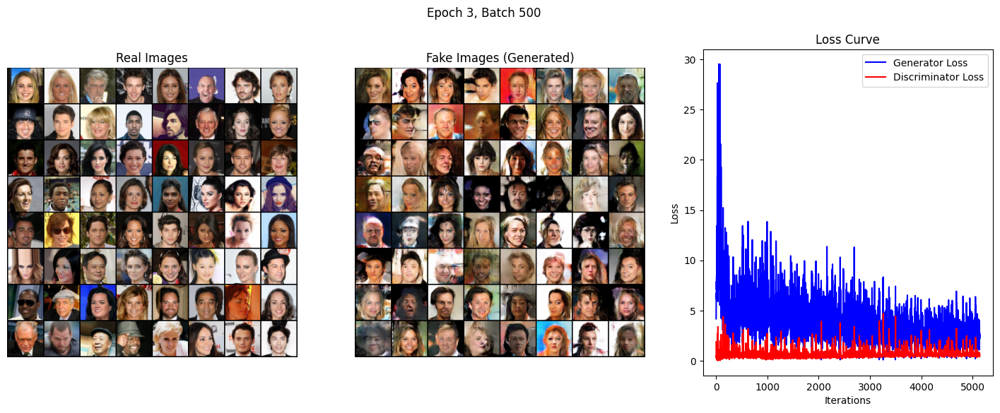

[3/5][500/1547] Loss_D: 0.6197 Loss_G: 1.4400 D(x): 0.6895 D(G(z)): 0.1728/0.2805
[3/5][550/1547] Loss_D: 0.8328 Loss_G: 3.6371 D(x): 0.8544 D(G(z)): 0.4391/0.0375
[3/5][600/1547] Loss_D: 0.8893 Loss_G: 1.0808 D(x): 0.5215 D(G(z)): 0.1133/0.3993
[3/5][650/1547] Loss_D: 0.8787 Loss_G: 1.2058 D(x): 0.4991 D(G(z)): 0.0343/0.3586
[3/5][700/1547] Loss_D: 0.6642 Loss_G: 1.6366 D(x): 0.6623 D(G(z)): 0.1648/0.2416
[3/5][750/1547] Loss_D: 1.4335 Loss_G: 5.0851 D(x): 0.9677 D(G(z)): 0.6842/0.0104
[3/5][800/1547] Loss_D: 0.6173 Loss_G: 3.1464 D(x): 0.8627 D(G(z)): 0.3379/0.0557
[3/5][850/1547] Loss_D: 0.5872 Loss_G: 1.8457 D(x): 0.6445 D(G(z)): 0.0867/0.1983
[3/5][900/1547] Loss_D: 0.6046 Loss_G: 2.8868 D(x): 0.8371 D(G(z)): 0.3106/0.0717
[3/5][950/1547] Loss_D: 1.0992 Loss_G: 3.2730 D(x): 0.8313 D(G(z)): 0.5320/0.0546


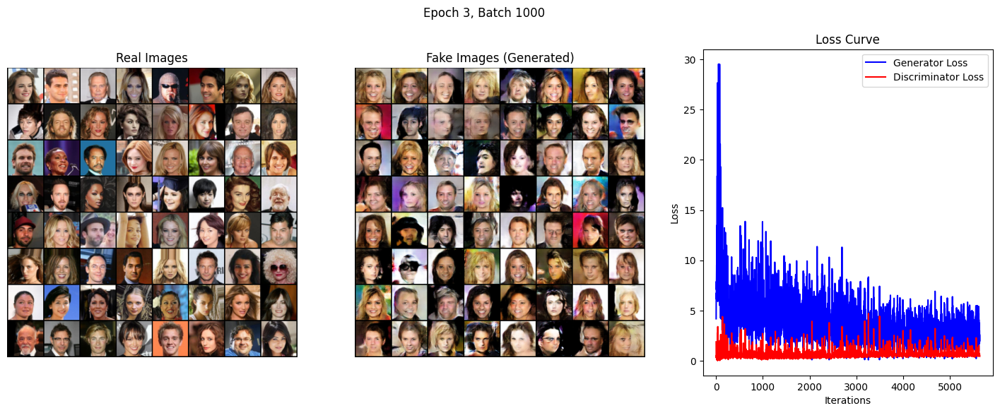

[3/5][1000/1547] Loss_D: 0.7236 Loss_G: 2.9739 D(x): 0.7980 D(G(z)): 0.3507/0.0648
[3/5][1050/1547] Loss_D: 0.5646 Loss_G: 1.4987 D(x): 0.6592 D(G(z)): 0.0973/0.2701
[3/5][1100/1547] Loss_D: 0.8636 Loss_G: 3.7427 D(x): 0.9353 D(G(z)): 0.4981/0.0362
[3/5][1150/1547] Loss_D: 0.4564 Loss_G: 2.9873 D(x): 0.8199 D(G(z)): 0.2063/0.0646
[3/5][1200/1547] Loss_D: 0.8541 Loss_G: 1.1000 D(x): 0.5494 D(G(z)): 0.1292/0.3799
[3/5][1250/1547] Loss_D: 0.5241 Loss_G: 2.0242 D(x): 0.7014 D(G(z)): 0.1150/0.1638
[3/5][1300/1547] Loss_D: 0.7480 Loss_G: 1.7372 D(x): 0.6710 D(G(z)): 0.2342/0.2241
[3/5][1350/1547] Loss_D: 0.8253 Loss_G: 3.0169 D(x): 0.8905 D(G(z)): 0.4683/0.0649
[3/5][1400/1547] Loss_D: 0.6387 Loss_G: 1.9937 D(x): 0.7177 D(G(z)): 0.2136/0.1671
[3/5][1450/1547] Loss_D: 0.5801 Loss_G: 2.0004 D(x): 0.7296 D(G(z)): 0.1938/0.1685


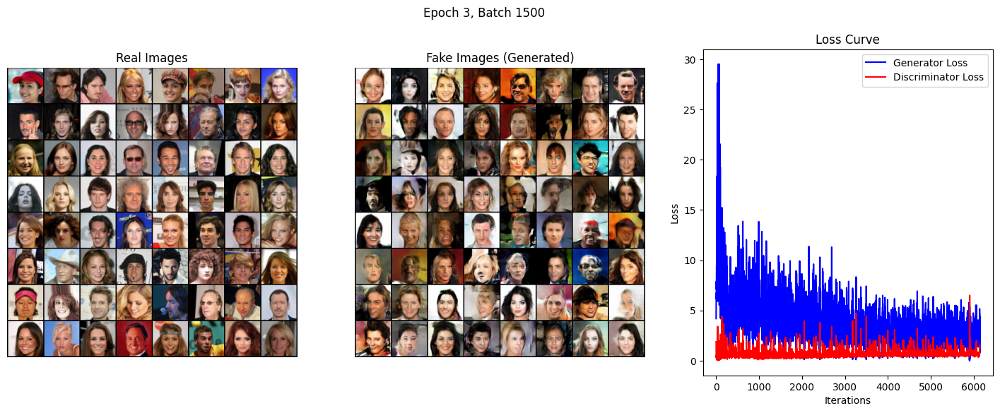

[3/5][1500/1547] Loss_D: 1.0173 Loss_G: 4.4933 D(x): 0.9060 D(G(z)): 0.5214/0.0191


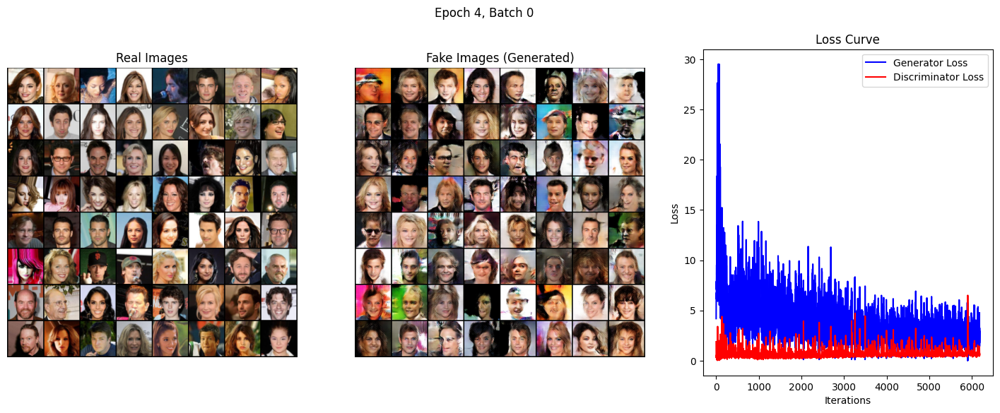

[4/5][0/1547] Loss_D: 0.8077 Loss_G: 3.5260 D(x): 0.8491 D(G(z)): 0.4245/0.0434
[4/5][50/1547] Loss_D: 0.3838 Loss_G: 2.5077 D(x): 0.7769 D(G(z)): 0.0963/0.1095
[4/5][100/1547] Loss_D: 0.4704 Loss_G: 2.0480 D(x): 0.7644 D(G(z)): 0.1577/0.1670
[4/5][150/1547] Loss_D: 1.1321 Loss_G: 1.1112 D(x): 0.4018 D(G(z)): 0.0614/0.3839
[4/5][200/1547] Loss_D: 1.7624 Loss_G: 4.3269 D(x): 0.9755 D(G(z)): 0.7567/0.0195
[4/5][250/1547] Loss_D: 0.4833 Loss_G: 2.9469 D(x): 0.8954 D(G(z)): 0.2824/0.0699
[4/5][300/1547] Loss_D: 2.0718 Loss_G: 7.0579 D(x): 0.9773 D(G(z)): 0.8366/0.0016
[4/5][350/1547] Loss_D: 0.7357 Loss_G: 1.1989 D(x): 0.5626 D(G(z)): 0.0704/0.3482
[4/5][400/1547] Loss_D: 0.5602 Loss_G: 1.8393 D(x): 0.7271 D(G(z)): 0.1669/0.2065
[4/5][450/1547] Loss_D: 1.1745 Loss_G: 4.5597 D(x): 0.8859 D(G(z)): 0.5847/0.0163


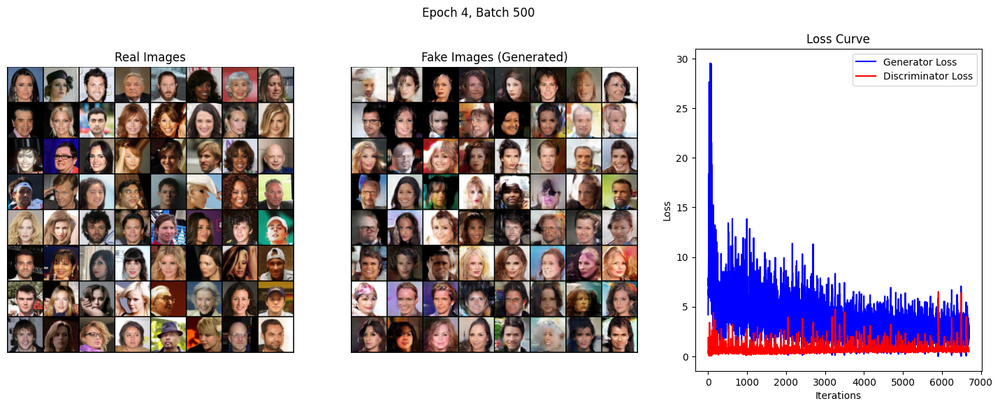

[4/5][500/1547] Loss_D: 0.5160 Loss_G: 2.5301 D(x): 0.8371 D(G(z)): 0.2625/0.0984
[4/5][550/1547] Loss_D: 1.0372 Loss_G: 5.7758 D(x): 0.9351 D(G(z)): 0.5664/0.0052
[4/5][600/1547] Loss_D: 0.6342 Loss_G: 2.0527 D(x): 0.6914 D(G(z)): 0.1895/0.1614
[4/5][650/1547] Loss_D: 0.7751 Loss_G: 2.7127 D(x): 0.7429 D(G(z)): 0.3255/0.0846
[4/5][700/1547] Loss_D: 0.7827 Loss_G: 4.0254 D(x): 0.8839 D(G(z)): 0.4416/0.0235
[4/5][750/1547] Loss_D: 0.4741 Loss_G: 2.4602 D(x): 0.8412 D(G(z)): 0.2316/0.1098
[4/5][800/1547] Loss_D: 0.5774 Loss_G: 3.6245 D(x): 0.8993 D(G(z)): 0.3362/0.0373
[4/5][850/1547] Loss_D: 0.6945 Loss_G: 2.2882 D(x): 0.6939 D(G(z)): 0.2264/0.1412
[4/5][900/1547] Loss_D: 0.8742 Loss_G: 1.4164 D(x): 0.4857 D(G(z)): 0.0644/0.2992
[4/5][950/1547] Loss_D: 0.6629 Loss_G: 3.0353 D(x): 0.8017 D(G(z)): 0.3087/0.0687


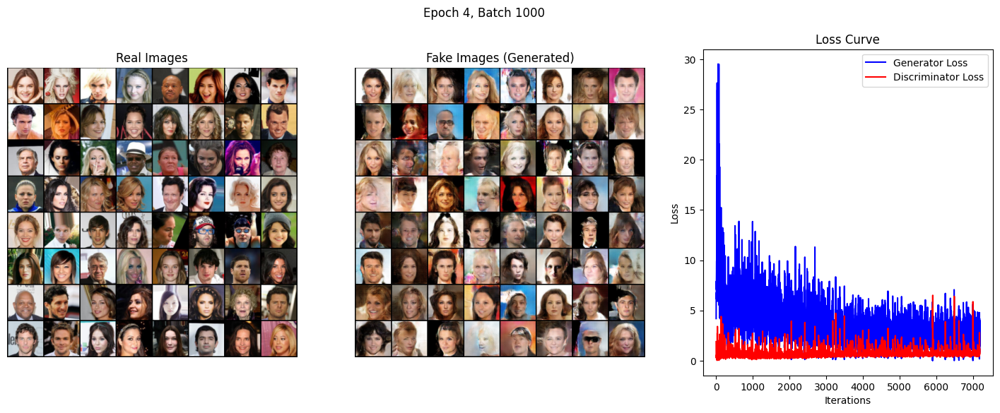

[4/5][1000/1547] Loss_D: 0.7962 Loss_G: 3.1184 D(x): 0.7814 D(G(z)): 0.3773/0.0628
[4/5][1050/1547] Loss_D: 0.6464 Loss_G: 1.6898 D(x): 0.6611 D(G(z)): 0.1583/0.2176
[4/5][1100/1547] Loss_D: 0.5172 Loss_G: 3.1267 D(x): 0.8960 D(G(z)): 0.3025/0.0577
[4/5][1150/1547] Loss_D: 0.5925 Loss_G: 3.4850 D(x): 0.9132 D(G(z)): 0.3526/0.0410
[4/5][1200/1547] Loss_D: 0.8036 Loss_G: 4.3687 D(x): 0.9166 D(G(z)): 0.4647/0.0178
[4/5][1250/1547] Loss_D: 0.4039 Loss_G: 2.4398 D(x): 0.7894 D(G(z)): 0.1307/0.1119
[4/5][1300/1547] Loss_D: 0.5151 Loss_G: 2.7438 D(x): 0.8158 D(G(z)): 0.2406/0.0842
[4/5][1350/1547] Loss_D: 0.9726 Loss_G: 0.4204 D(x): 0.4528 D(G(z)): 0.0598/0.6901
[4/5][1400/1547] Loss_D: 0.6504 Loss_G: 1.8113 D(x): 0.6370 D(G(z)): 0.1147/0.2167
[4/5][1450/1547] Loss_D: 0.4238 Loss_G: 2.1042 D(x): 0.8016 D(G(z)): 0.1612/0.1530


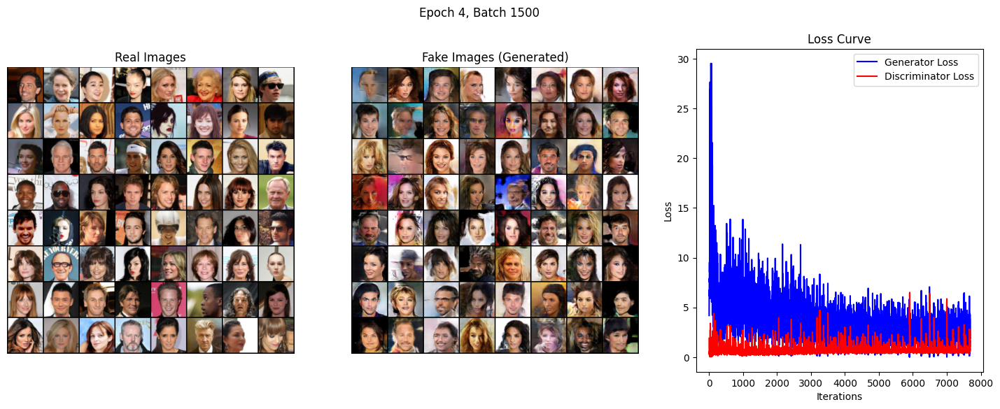

[4/5][1500/1547] Loss_D: 0.7699 Loss_G: 3.2222 D(x): 0.8414 D(G(z)): 0.4052/0.0550


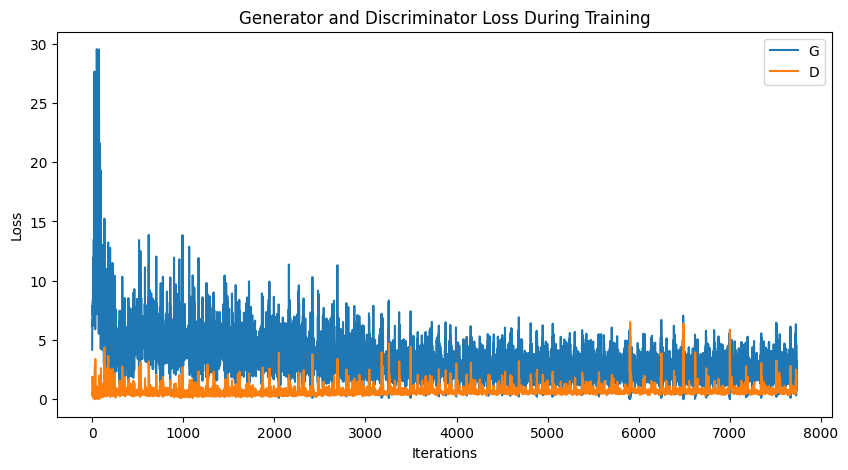

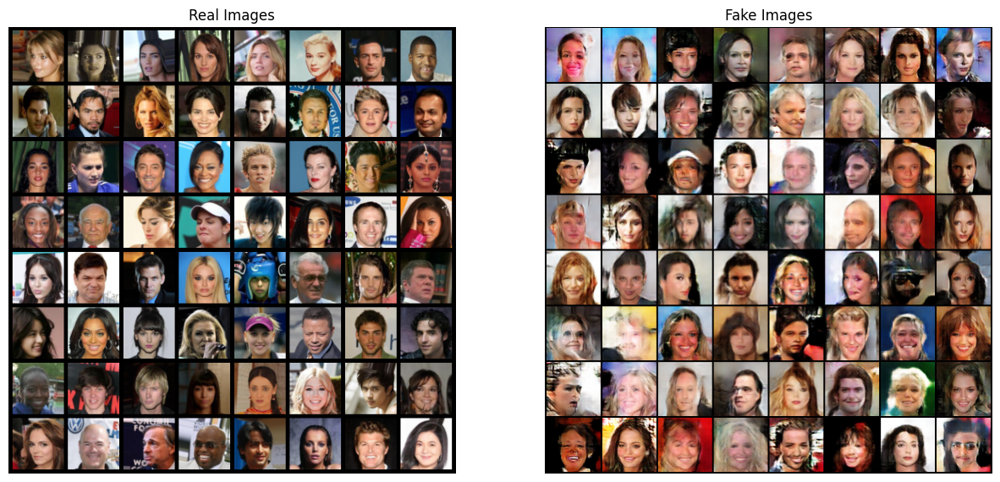

In [17]:


# Training function for standard DCGAN
def train_dcgan():
    # Get dataloader
    dataloader = get_celeba_dataset()
    
    # Create the generator and discriminator
    netG = Generator().to(device)
    netD = Discriminator().to(device)
    
    # Apply the weights_init function to randomly initialize all weights
    netG.apply(weights_init)
    netD.apply(weights_init)
    
    # Initialize BCELoss function
    criterion = nn.BCELoss()
    
    # Create batch of latent vectors that we will use to visualize
    # the progression of the generator
    fixed_noise = torch.randn(64, nz, 1, 1, device=device)
    
    # Establish convention for real and fake labels during training
    real_label = 1.
    fake_label = 0.
    
    # Setup Adam optimizers for both G and D
    optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
    optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))
    
    # Lists to keep track of progress
    img_list = []
    G_losses = []
    D_losses = []
    
    print("Starting Training Loop...")
    # For each epoch
    for epoch in range(num_epochs):
        # For each batch in the dataloader
        for i, data in enumerate(dataloader, 0):
            ############################
            # Update Discriminator: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            
            # Train with real batch
            netD.zero_grad()
            # Format batch
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            
            # Forward pass real batch through D
            output = netD(real_cpu).view(-1)
            
            # Calculate loss on real batch
            errD_real = criterion(output, label)
            
            # Calculate gradients for D in backward pass
            errD_real.backward()
            D_x = output.mean().item()
            
            # Train with fake batch
            # Generate batch of latent vectors
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            
            # Generate fake image batch with G
            fake = netG(noise)
            label.fill_(fake_label)
            
            # Classify all fake batch with D
            output = netD(fake.detach()).view(-1)
            
            # Calculate D's loss on the fake batch
            errD_fake = criterion(output, label)
            
            # Calculate the gradients for this batch, accumulated
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            
            # Compute error of D as sum over the fake and the real batches
            errD = errD_real + errD_fake
            
            # Update D
            optimizerD.step()
            
            ############################
            # Update G network: maximize log(D(G(z)))
            ###########################
            netG.zero_grad()
            label.fill_(real_label)  # fake labels are real for generator cost
            
            # Since we just updated D, perform another forward pass of all-fake batch through D
            output = netD(fake).view(-1)
            
            # Calculate G's loss based on this output
            errG = criterion(output, label)
            
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = output.mean().item()
            
            # Update G
            optimizerG.step()
            
            
            # Every X batches, visualize real vs fake images and loss
            if i % 500 == 0:# Change 500 to any frequency you prefer
                visualize_training(real_cpu, fake.detach(), G_losses, D_losses, epoch, i)
            # Output training stats
            if i % 50 == 0:
                print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')
            
            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())
            
            # Check how the generator is doing by saving G's output on fixed_noise
            if (epoch == num_epochs-1) and (i == len(dataloader)-1):
                with torch.no_grad():
                    fake = netG(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        
        # Save model checkpoints after each epoch
        torch.save(netG.state_dict(), f'generator_epoch_{epoch}.pth')
        torch.save(netD.state_dict(), f'discriminator_epoch_{epoch}.pth')
    
    # Visualization after training
    plt.figure(figsize=(10, 5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(G_losses, label="G")
    plt.plot(D_losses, label="D")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.savefig("dcgan_loss_plot.png")
    
    # Grab a batch of real images from the dataloader
    real_batch = next(iter(dataloader))
    
    # Plot the real images
    plt.figure(figsize=(15, 15))
    plt.subplot(1, 2, 1)
    plt.axis("off")
    plt.title("Real Images")
    plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(), (1, 2, 0)))
    
    # Plot the fake images from the last epoch
    plt.subplot(1, 2, 2)
    plt.axis("off")
    plt.title("Fake Images")
    plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
    plt.savefig("dcgan_generated_images.png")
    
    return netG, netD, G_losses, D_losses, img_list

if __name__ == "__main__":
    train_dcgan()